In [1]:
import pandas as pd
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as pyplot
from pandas_profiling import ProfileReport
import io
#!pip install -U pandas-profiling

#upload colab file
#from google.colab import files
#from google.colab import drive
#drive.mount('/content/gdrive') #Mount MachineLearning
#uploaded = files.upload()

#Read local file
import os
for dirname, _, filenames in os.walk('../data/'):
    for filename in filenames:
        print(os.path.join(dirname, filename))




In [3]:
tweet_data = pd.read_csv('./tweet_data.csv') #local
#tweet_data = pd.read_csv(io.BytesIO(uploaded['tweet_data.csv'])) #colab
tweet_data.head()

,screen_name,friends_count,tweets_count,linkedin,snapchat,instagram,facebook,followers_count,favourites_count,qtyMentions,qtyHashtags,qtyUrls,qtyEmojis,qtyUppercase,profile_pic_gender,tweets,age
0,ezequielreal10,659,190,0,0,0,0,262,1611,0.09,0.04,0.00,2.05,4.18,0,18 del compañero 😌🎉😉. salio algo de play 3🔛😊....,10-17
1,caamilachaparro,1559,33525,0,0,0,0,2990,15112,0.56,0.00,0.11,0.73,2.00,2,se fueron las otras así que vuelvo jajajaja. ...,18-24
2,crisalonsofran,2120,24051,0,0,0,0,2160,2377,0.82,0.26,0.54,0.31,2.98,2,"¡buen día mundo! ¡buenas noches mundo! ""si no ...",35-49
3,jluisfoglia,150,4157,0,0,0,0,98,1128,0.91,0.09,0.21,0.02,23.69,1,cambio juez: sale un bueno para nada y entra ...,10-17
4,maiikoldadamia,131,1096,0,0,0,0,189,849,0.20,0.00,0.00,0.75,3.08,1,"creo que ya entre como 20 veces a wsp, a tw y ...",10-17


In [4]:
tweet_data.columns

Index(['screen_name', 'friends_count', 'tweets_count', 'linkedin', 'snapchat',
       'instagram', 'facebook', 'followers_count', 'favourites_count',
       'qtyMentions', 'qtyHashtags', 'qtyUrls', 'qtyEmojis', 'qtyUppercase',
       'profile_pic_gender', 'tweets', 'age'],
      dtype='object')

In [5]:
# Convertimos age a variables categoricas.
tweet_data["age"] = tweet_data["age"].map({"10-17":0, "18-24":1, "25-34" : 2 , "35-49":3, "50-xx":4})
tweet_data["age"] = tweet_data["age"].astype(int)
tweet_data.head()

,screen_name,friends_count,tweets_count,linkedin,snapchat,instagram,facebook,followers_count,favourites_count,qtyMentions,qtyHashtags,qtyUrls,qtyEmojis,qtyUppercase,profile_pic_gender,tweets,age
0,ezequielreal10,659,190,0,0,0,0,262,1611,0.09,0.04,0.00,2.05,4.18,0,18 del compañero 😌🎉😉. salio algo de play 3🔛😊....,0
1,caamilachaparro,1559,33525,0,0,0,0,2990,15112,0.56,0.00,0.11,0.73,2.00,2,se fueron las otras así que vuelvo jajajaja. ...,1
2,crisalonsofran,2120,24051,0,0,0,0,2160,2377,0.82,0.26,0.54,0.31,2.98,2,"¡buen día mundo! ¡buenas noches mundo! ""si no ...",3
3,jluisfoglia,150,4157,0,0,0,0,98,1128,0.91,0.09,0.21,0.02,23.69,1,cambio juez: sale un bueno para nada y entra ...,0
4,maiikoldadamia,131,1096,0,0,0,0,189,849,0.20,0.00,0.00,0.75,3.08,1,"creo que ya entre como 20 veces a wsp, a tw y ...",0


In [6]:

profile = ProfileReport(tweet_data, title="Pandas Profiling Report", html={'style':{'full_width':True}})
profile.to_widgets()

/usr/local/lib/python3.6/dist-packages/pandas_profiling/profile_report.py:397: UserWarning: Ipywidgets is not yet fully supported on Google Colab (https://github.com/googlecolab/colabtools/issues/60).As an alternative, you can use the HTML report. See the documentation for more information.
  "Ipywidgets is not yet fully supported on Google Colab (https://github.com/googlecolab/colabtools/issues/60)."


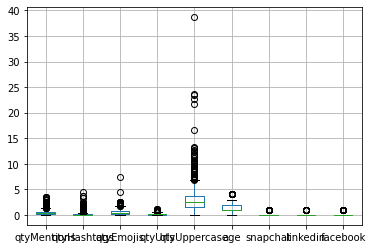

In [35]:
boxplot = tweet_data.boxplot(column=['qtyMentions', 'qtyHashtags', 'qtyEmojis', 'qtyUrls','qtyUppercase','age','snapchat', 'linkedin', 'facebook' ])

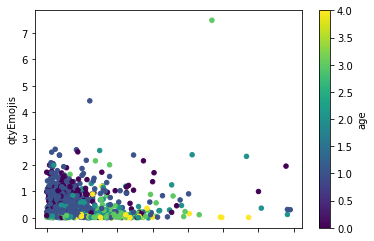

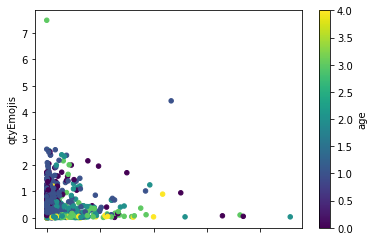

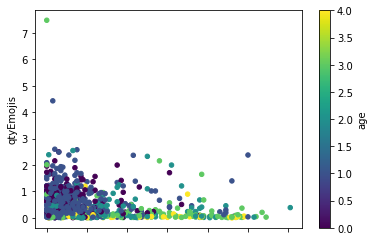

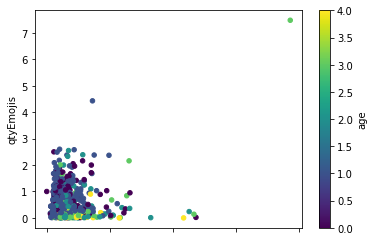

In [37]:
#Scattering hashtags & emojis
scatter = tweet_data.plot.scatter(x='qtyMentions',
                      y='qtyEmojis',
                      c='age',
                      colormap='viridis')
scatter = tweet_data.plot.scatter(x='qtyHashtags',
                      y='qtyEmojis',
                      c='age',
                      colormap='viridis')
scatter = tweet_data.plot.scatter(x='qtyUrls',
                      y='qtyEmojis',
                      c='age',
                      colormap='viridis')
scatter = tweet_data.plot.scatter(x='qtyUppercase',
                      y='qtyEmojis',
                      c='age',
                      colormap='viridis')

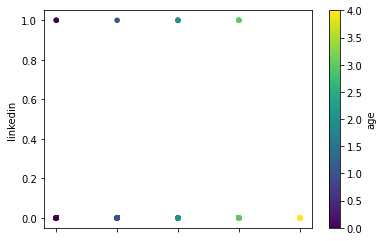

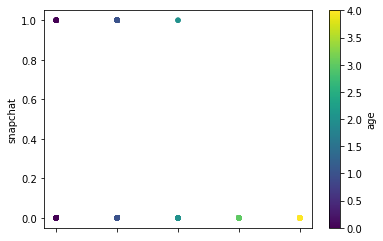

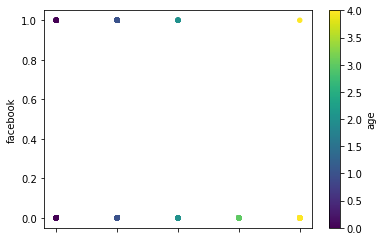

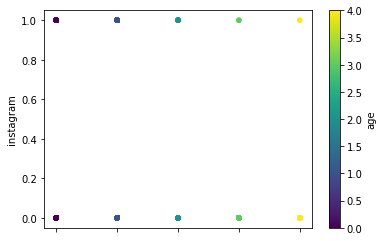

In [55]:
#Scattering redes sociales
scatter = tweet_data.plot.scatter(x='age',
                      y='linkedin',
                      c='age',
                      colormap='viridis')

scatter = tweet_data.plot.scatter(x='age',
                      y='snapchat',
                      c='age',
                      colormap='viridis')
scatter = tweet_data.plot.scatter(x='age',
                      y='facebook',
                      c='age',
                      colormap='viridis')
scatter = tweet_data.plot.scatter(x='age',
                      y='instagram',
                      c='age',
                      colormap='viridis')



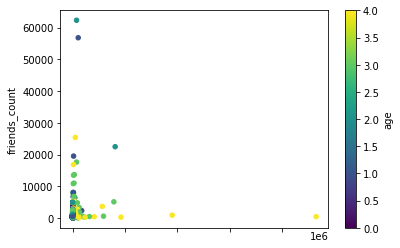

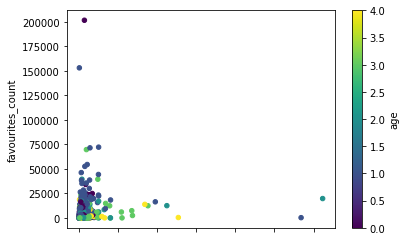

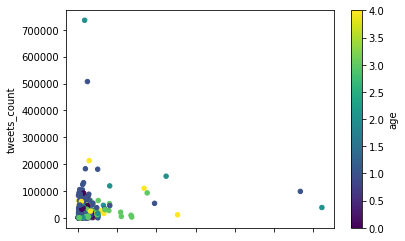

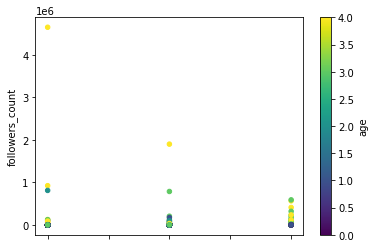

In [61]:
#Scattering seguidores y amigos
scatter = tweet_data.plot.scatter(x='followers_count',
                      y='friends_count',
                      c='age',
                      colormap='viridis')

scatter = tweet_data.plot.scatter(x='friends_count',
                      y='favourites_count',
                      c='age',
                      colormap='viridis')
scatter = tweet_data.plot.scatter(x='friends_count',
                      y='tweets_count',
                      c='age',
                      colormap='viridis')
scatter = tweet_data.plot.scatter(x='profile_pic_gender',
                      y='followers_count',
                      c='age',
                      colormap='viridis')



In [ ]:
#Conclusiones

#Gracias al profiling y al scattering anterior concluimos que prácticamente nadie tiene linkedin del dataset y es un dato sin utilidad.
#El snapchat está mucho más presente en los primeros 3 rangos etáreos, que incluyen a las personas más jóvenes inclusive hasta los 34.
#Los más jóvenes usan más emojis.
#A partir del rango 35-49 los usuarios hacen más menciones.
#Los hashtags no son tan comunes entre los más jóvenes.
#Los más veteranos comparten mayor cantidad de urls.
#Los más jóvenes presentan una cantidad mayor de tweets.
#Los jóvenes tienen más favoritos en sus tweets.
